$$ Credit \space Score  $$
$$ Machine \space Learning \space 1 $$
$$ Decision  \space Tree \space Classifier  $$

# `01` Import Necessary Libraries

## `i` Default Libraries

In [1]:
from pathlib import Path
import pandas as pd
import numpy as np
import tarfile
import urllib.request

## `ii` Additional Libraries
Add imports for additional libraries you used throughout the notebook

In [2]:
from ydata_profiling import ProfileReport
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns

from sklearn import datasets, linear_model
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_score, recall_score, f1_score
from sklearn.impute import KNNImputer
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text

pd.set_option('display.max_columns', None)

import warnings
warnings.simplefilter("ignore")

----------------------------

# `02` Load & Split Data

Note: Make sure the `Data` folder attached with the notebook is in the same path for this cell to work properly.

[Dataset Link](https://www.kaggle.com/datasets/parisrohan/credit-score-classification)

In [3]:
data = pd.read_csv('/content/train.csv')
data.head().style.background_gradient(cmap='Blues')

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",3,7,11.27,4.000000,_,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,nan,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",-1,nan,11.27,4.000000,Good,809.98,31.944960,nan,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,nan,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",3,7,_,4.000000,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,nan,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",5,4,6.27,4.000000,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan",6,nan,11.27,4.000000,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good


---
## `#` About Data:
- You are working as a data scientist in a global finance company. Over the years, the company has collected basic bank details and gathered a lot of credit-related information.
-  The management wants to build an intelligent system to segregate the people into credit score brackets to reduce the manual efforts. <br>
---
- The columns are as follows, their names are pretty self explanitory:
  - 1. `ID`: Unique identifier for each entry.  
  - 2. `Customer_ID`: Unique identifier for each customer.  
  - 3. `Month`: The month of the recorded transaction or data entry.  
  - 4. `Name`: Customer’s full name.  
  - 5. `Age`: The age of the customer in years.  
  - 6. `SSN`: Social Security Number (used for identity verification).  
  - 7. `Occupation`: The profession of the customer.  
  - 8. `Annual_Income`: The customer’s yearly income in USD.  
  - 9. `Monthly_Inhand_Salary`: The customer’s monthly net salary after deductions.  
  - 10. `Num_Bank_Accounts`: The number of bank accounts the customer holds.  
  - 11. `Interest_Rate`: Interest rate applied to the customer’s credit card.  
  - 12. `Num_of_Loan`: The total number of loans taken by the customer.  
  - 13. `Type_of_Loan`: The type(s) of loan taken (e.g., home loan, personal loan, car loan).  
  - 14. `Delay_from_due_date`: The average number of days a payment is delayed from its due date.  
  - 15. `Num_of_Delayed_Payment`: The total number of payments delayed by the customer.  
  - 16. `Changed_Credit_Limit`: The percentage change in the customer’s credit limit.  
  - 17. `Num_Credit_Inquiries`: The number of times the customer has applied for credit.  
  - 18. `Credit_Mix`: Classification of the types of credit accounts (e.g., revolving, installment).  
  - 19. `Outstanding_Debt`: The total amount of debt the customer still owes in USD.  
  - 20. `Credit_Utilization_Ratio`: The percentage of the credit limit that the customer is using.  
  - 21. `Credit_History_Age`: The number of years the customer has had a credit history.  
  - 22. `Payment_of_Min_Amount`: Whether the customer pays only the minimum amount due on credit cards (Yes/No).  
  - 23. `Total_EMI_per_month`: The total amount of Equated Monthly Installments (EMI) the customer pays.  
  - 24. `Amount_invested_monthly`: The amount the customer invests per month in USD.  
  - 25. `Payment_Behaviour`: A summary of how the customer makes payments (full, minimum, late, etc.).  
  - 26. `Monthly_Balance`: The remaining balance the customer has at the end of each month in USD.  
  - 27. `Credit_Score`: The classification of the customer’s creditworthiness (Poor, Standard, Good).  

---
## `#` Questions:
### <u>General Questions :</u>

- 1- Are there any missing values in our dataset?
- 2- Are there any duplicated values in our dataset?
- 3- What is the numerical description of our dataset?
- 4- What is the categorical description of our dataset?
- 5- What is the number of unique values in each column in our dataset?
- 6- Initial Data Assessment.
- 7- what is the distribution of each numerical columns?
- 8- what is the count of each categorical column?
- 9- Is there outliers in our data?

    


---
## `#` Split Data

Split data via the method you see fit to ensure that you can estimate the generalization error.

In [4]:
# Split data into training, validation, and testing sets
X = data.drop('Credit_Score', axis=1)
y = data['Credit_Score']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=0.5, random_state=42)

----------------

# `03` Exploratory Data Analysis (EDA)

## `i` Simple Analysis

Preview data, perform statistical data analysis and explore as much as needed to better understand the data set we're dealing with.

`Notes:`
- Feel free to look up EDA approaches online for inspiration (however you **must understand** everything and not copy paste).
- Make sure to add notes and insights extracted from your analysis.


In [5]:
X_train.shape

(70000, 27)

In [6]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 70000 entries, 76513 to 15795
Data columns (total 27 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ID                        70000 non-null  object 
 1   Customer_ID               70000 non-null  object 
 2   Month                     70000 non-null  object 
 3   Name                      63016 non-null  object 
 4   Age                       70000 non-null  object 
 5   SSN                       70000 non-null  object 
 6   Occupation                70000 non-null  object 
 7   Annual_Income             70000 non-null  object 
 8   Monthly_Inhand_Salary     59510 non-null  float64
 9   Num_Bank_Accounts         70000 non-null  int64  
 10  Num_Credit_Card           70000 non-null  int64  
 11  Interest_Rate             70000 non-null  int64  
 12  Num_of_Loan               70000 non-null  object 
 13  Type_of_Loan              61973 non-null  object 
 14  Delay_f

In [7]:
#Check Missing
X_train.isnull().sum()

,0
ID,0
Customer_ID,0
Month,0
Name,6984
Age,0
SSN,0
Occupation,0
Annual_Income,0
Monthly_Inhand_Salary,10490
Num_Bank_Accounts,0


In [8]:
X_train.isna().sum()/X_train.shape[0]*100

,0
ID,0.000000
Customer_ID,0.000000
Month,0.000000
Name,9.977143
Age,0.000000
SSN,0.000000
Occupation,0.000000
Annual_Income,0.000000
Monthly_Inhand_Salary,14.985714
Num_Bank_Accounts,0.000000


- Tere is alot of missing ,so I may impute or drop it.

In [9]:
#check uniqueness
X_train.nunique()

,0
ID,70000
Customer_ID,12498
Month,8
Name,10132
Age,1302
SSN,12499
Occupation,16
Annual_Income,17274
Monthly_Inhand_Salary,13119
Num_Bank_Accounts,727


### Numerical Columns:

In [10]:
X_train.describe(exclude = "object").T.style.background_gradient(cmap='Blues')

,count,mean,std,min,25%,50%,75%,max
Monthly_Inhand_Salary,59510.000000,4201.948265,3175.780459,303.645417,1633.646667,3107.431667,5971.186667,15204.633333
Num_Bank_Accounts,70000.000000,17.419629,118.820416,-1.000000,3.000000,6.000000,7.000000,1798.000000
Num_Credit_Card,70000.000000,22.399400,128.248416,0.000000,4.000000,5.000000,7.000000,1499.000000
Interest_Rate,70000.000000,73.420229,471.129553,1.000000,8.000000,13.000000,20.000000,5797.000000
Delay_from_due_date,70000.000000,21.022671,14.836833,-5.000000,10.000000,18.000000,28.000000,67.000000
Num_Credit_Inquiries,68597.000000,27.870053,193.174241,0.000000,3.000000,6.000000,9.000000,2597.000000
Credit_Utilization_Ratio,70000.000000,32.286738,5.122776,20.000000,28.046452,32.299547,36.507653,50.000000
Total_EMI_per_month,70000.000000,1424.588024,8372.806726,0.000000,30.292881,69.266164,162.343223,82331.000000


### Categorical Columns:

In [11]:
X_train.describe(include = "object").T.style.background_gradient(cmap='Blues')

,count,unique,top,freq
ID,70000,70000,0x1d653,1
Customer_ID,70000,12498,CUS_0x1f9c,8
Month,70000,8,May,8814
Name,63016,10132,Stevex,35
Age,70000,1302,28,2002
SSN,70000,12499,#F%$D@*&8,3909
Occupation,70000,16,_______,4951
Annual_Income,70000,17274,20867.67,14
Num_of_Loan,70000,300,3,10137
Type_of_Loan,61973,6258,Not Specified,1020


---
### <u>Check outliers:</u>

In [12]:
numeric_cols = X_train.select_dtypes(include=["float64"])

Q1 = numeric_cols.quantile(0.25)
Q3 = numeric_cols.quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers_mask = (numeric_cols < lower_bound) | (numeric_cols > upper_bound)

outlier_counts = outliers_mask.sum(axis=0)

total_rows = numeric_cols.shape[0]
outlier_percentage = (outlier_counts / total_rows) * 100

outliers_summary = pd.DataFrame({
    "Number of Outliers": outlier_counts,
    "Outlier Percentage": outlier_percentage
})

outliers_summary.style.background_gradient(cmap='Blues')

,Number of Outliers,Outlier Percentage
Monthly_Inhand_Salary,1133,1.618571
Num_Credit_Inquiries,1181,1.687143
Credit_Utilization_Ratio,4,0.005714
Total_EMI_per_month,4746,6.780000


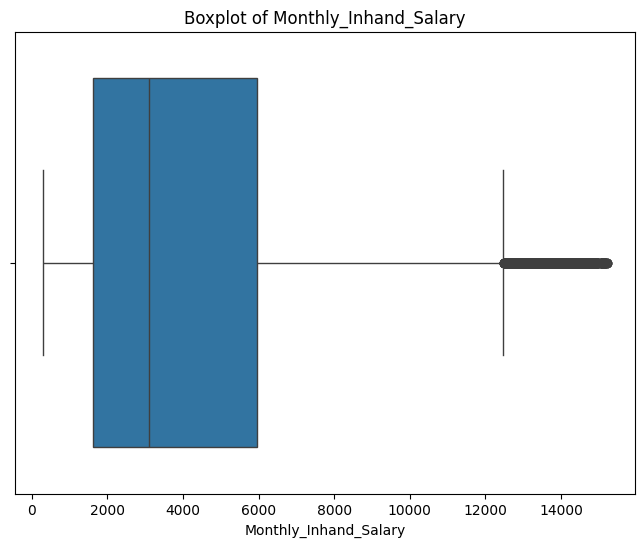

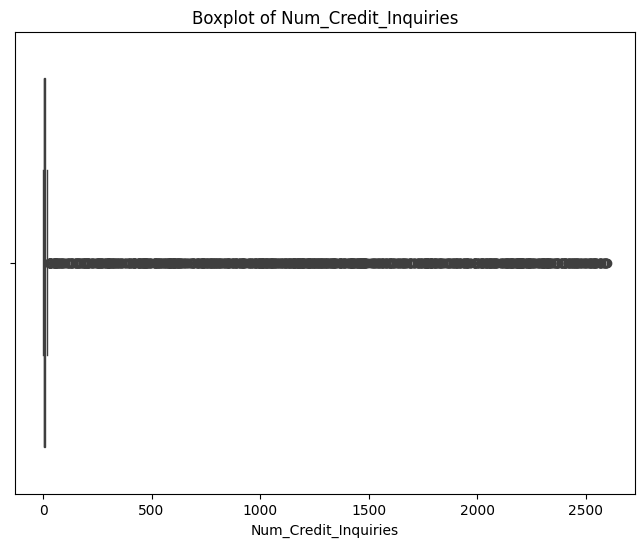

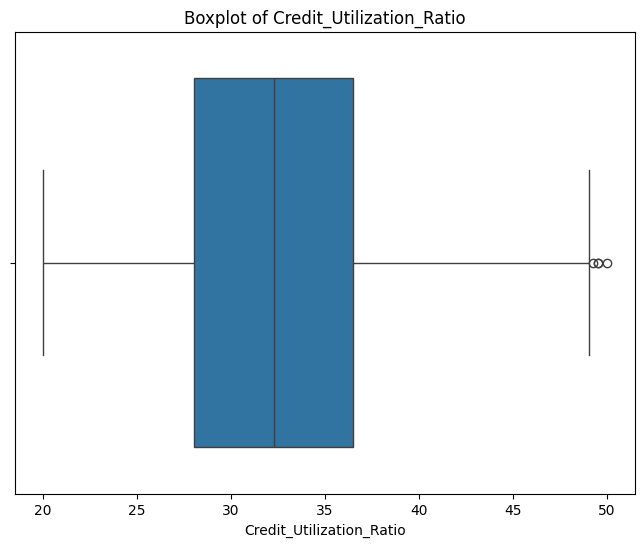

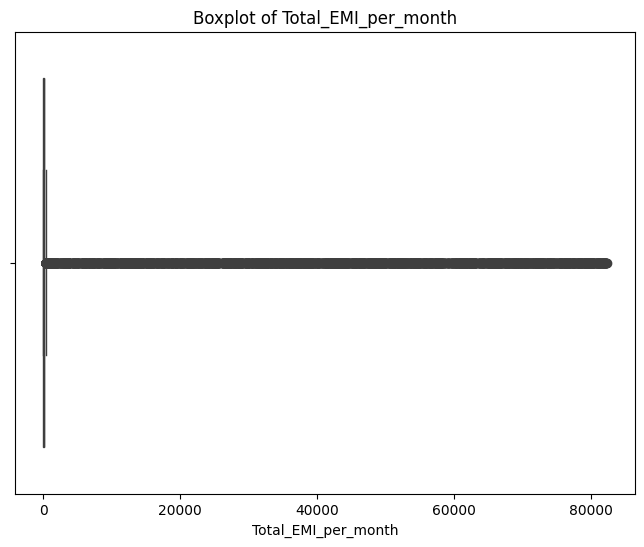

In [13]:
numeric_cols = X_train.select_dtypes(include=["float64"]).columns

for col in numeric_cols:
    plt.figure(figsize=(8, 6))

    sns.boxplot(x= X_train[col], orient="h")

    plt.xlabel(col)
    plt.title(f"Boxplot of {col}")

    plt.show()

## `ii` Visual Analysis

Plot graphs and relations in order to gain more insights about the data set, identify patterns, and make assumptions.

`Notes:`
- Feel free to look up visual EDA approaches online for inspiration (however you **must understand** everything and not copy paste).
- Make sure to add notes and insights extracted from your analysis.

In [14]:
report = ProfileReport(X_train, title="Credit Data Report", explorative=True)
report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

---


## -<u>`Insights`:</u>

### **General Overview**  
- The dataset contains **80,000 observations** and **28 variables**.  
- **2.1% of the data is missing**, with **48,024 missing cells** in total.  
- There are **no duplicate rows**, meaning all records are unique.  
- The dataset occupies **109 MB** in memory, with each record averaging **1.4 KB**.

---

### **Data Quality & Issues**  
1. **Missing Values:**  
   - Several columns have missing data, including:
     - **"Name" (10%)**
     - **"Type_of_Loan" (11.4%)**
     - **"Num_of_Delayed_Payment" (7%)**
     - **"Credit_History_Age" (9%)**
     - **"Monthly_Inhand_Salary" (15.1%)**
     - **"Amount_invested_monthly" (4.5%)**
     - **"Monthly_Balance" (1.2%)**  
   - Missing values may need imputation or handling, depending on their importance.

2. **Potential Data Entry Issues:**  
   - **"Num_Bank_Accounts"** has negative values (**-1**), which is unrealistic.  
   - **"Delay_from_due_date"** also contains negative values, which may indicate early payments but need verification.  
   - **"SSN"** contains non-standard characters in some entries, indicating possible data corruption.  


---

### **Observations**  
1. **Customer Distribution & Uniqueness:**  
   - **"Customer_ID"** has **12,500 unique values**, meaning some customers appear multiple times.  
   - The **"ID"** column is completely unique, acting as a primary key.  

2. **Income & Financial Behavior:**  
   - The **average monthly in-hand salary** is **4,190.98**, but **15.1% of values are missing**.  
   - **"Num_Bank_Accounts"** has a high mean of **17.26**, but some values seem unrealistic (e.g., max **1,798** accounts).  
   - **"Num_Credit_Card"** averages **22.55**, which is quite high, suggesting potential data errors or a specific population.  
   - **"Credit_Utilization_Ratio"** has a range from **20.1% to 50%**, with an average of **32.27%**, indicating most customers are using a moderate portion of their credit limits.  

3. **Loan & Credit Patterns:**  
   - **"Type_of_Loan"** includes multiple loans per customer, suggesting customers may have multiple credit lines.  
   - **"Num_of_Delayed_Payment"** has **7% missing values**, which could impact credit risk analysis.  
   - **"Interest_Rate"** has a wide range (from **1% to 5797%**), which may indicate outliers or incorrect values.  

4. **Credit Score & Risk Analysis:**  
   - **"Credit_Score"** has 3 categories:
     - **Standard (53%)**
     - **Poor (29%)**
     - **Good (18%)**  
   - This suggests that a significant portion of customers have below-average credit ratings.  
   - **"Credit_Mix"** shows most customers fall into "Standard" (36%) and "Good" (24%), while others have missing or undefined credit mixes.  




----------------

# `04` Data Preparation

Perform data cleaning, feature engineering, scaling, dropping unwanted columns (such as IDs), etc. as needed to make sure it's ready for the model.

`Q` Is this dataset *skewed*?
- The dataset shows skewness in multiple variables:

  - **Right-skewed (highly skewed):**  
     - `Num_Bank_Accounts`, `Num_Credit_Card`, `Interest_Rate`, `Num_Credit_Inquiries`, and `Total_EMI_per_month` have extreme outliers, causing heavy right skewness.
  - **Moderately right-skewed:**  
       - `Monthly_Inhand_Salary` (Mean > Median) has moderate right skewness.

---
`Note:` You can take a sample from the training data to make the model training and fine-tuning faster.

Hints:
- It could be helpful to check `sklearn.preprocessing` module.

`i` Most important columns:
- `'Delay_from_due_date'`
- `'Outstanding_Debt'`
- `'Credit_Mix'`
- `'Payment_of_Min_Amount'`
- `'Num_Credit_Inquiries'`
- `'Interest_Rate'`
- `'Changed_Credit_Limit'`

In [15]:
important_cols = ['Delay_from_due_date', 'Outstanding_Debt', 'Credit_Mix',
                  'Payment_of_Min_Amount', 'Num_Credit_Inquiries',
                  'Interest_Rate', 'Changed_Credit_Limit', 'Credit_Score']

# Subset the data with important columns
data_important = data[important_cols]

# Separate features (X) and target (y)
X = data_important.drop('Credit_Score', axis=1)
y = data_important['Credit_Score']

# Split data into training, validation, and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=0.5, random_state=42)


---
`#`  `'Delay_from_due_date'`

In [16]:
X_train['Delay_from_due_date'].unique()

array([ 4, 16, 30,  7, 44, 45, -2,  2, 24, 27,  1,  9, 41, 23, 13, 11, 32,
       15, 25,  5, 29,  6,  8, 61, 58, 49, 21, 19, 12, 53, 14, 18, 56, 33,
       57, 37, 28, 36, 26,  0, 22, 35, 39, 65, 42, 20, -4, 50, 66, 60, 46,
       38, 47, 34, -1, 17, 55, 10, 67, 51, 43,  3, 54, 31, 40, 59, 48, 52,
       62, -5, -3, 64, 63])

In [17]:
X_train['Delay_from_due_date'].isna().sum()

0

- There is no null or strange values.

---
`#`  `'Outstanding_Debt'`

In [18]:
X_train['Outstanding_Debt'].unique()

array(['1145.77', '23.58', '142.19', ..., '3145.39_', '651.79_',
       '1417.89_'], dtype=object)

In [19]:
# Remove _
X_train['Outstanding_Debt'] = X_train['Outstanding_Debt'].str.replace('_','')

In [20]:
X_train['Outstanding_Debt'].isna().sum()

0

In [21]:
# Convert to float
X_train['Outstanding_Debt'] = X_train['Outstanding_Debt'].astype(float)

---
`#`  ` 'Changed_Credit_Limit'`

In [22]:
X_train['Changed_Credit_Limit'].value_counts()

,count
Changed_Credit_Limit,
_,1286
11.5,85
8.22,82
10.06,79
11.32,78
...,...
26.53,1
27.92,1
0.9500000000000002,1


In [23]:
# Replace '_' with NaN
X_train['Changed_Credit_Limit'] = X_train['Changed_Credit_Limit'].replace('_', np.nan)

# Convert to numeric
X_train['Changed_Credit_Limit'] = pd.to_numeric(X_train['Changed_Credit_Limit'], errors='coerce')

# Impute missing values using KNNImputer
imputer = KNNImputer(n_neighbors=5)
X_train['Changed_Credit_Limit'] = imputer.fit_transform(X_train[['Changed_Credit_Limit']])

In [24]:
# Convert to float
X_train['Changed_Credit_Limit'] = X_train['Changed_Credit_Limit'].astype(float)

In [25]:
X_train['Changed_Credit_Limit'].isna().sum()

0

---
`#`  `'Credit_Mix'`

In [26]:
X_train['Credit_Mix'].unique()

array(['Good', '_', 'Standard', 'Bad'], dtype=object)

In [27]:
# Replace '_' with NaN
X_train['Credit_Mix'] = X_train['Credit_Mix'].replace('_', np.nan)

# Fill missing values in 'Credit_Mix' with the mode
X_train['Credit_Mix'] = X_train['Credit_Mix'].fillna(X_train['Credit_Mix'].mode()[0])

In [28]:
# Encode 'Credit_Mix'
le1 = LabelEncoder()
X_train['Credit_Mix'] = le1.fit_transform(X_train['Credit_Mix'])

In [29]:
X_train['Credit_Mix'].isna().sum()

0

---
`#`  `'Payment_of_Min_Amount'`


In [30]:
X_train['Payment_of_Min_Amount'].unique()

array(['No', 'Yes', 'NM'], dtype=object)

In [31]:
# Replace '_' with NaN
X_train['Payment_of_Min_Amount'] = X_train['Payment_of_Min_Amount'].replace('NM', np.nan)

# Fill missing values in 'Payment_of_Min_Amount' with the mode
X_train['Payment_of_Min_Amount'] = X_train['Payment_of_Min_Amount'].fillna(X_train['Payment_of_Min_Amount'].mode()[0])

In [32]:
# Encode
le2 = LabelEncoder()
X_train['Payment_of_Min_Amount'] = le2.fit_transform(X_train['Payment_of_Min_Amount'])

In [33]:
X_train['Payment_of_Min_Amount'].isna().sum()

0

---
`#`  `'Num_Credit_Inquiries'`


In [34]:
X_train['Num_Credit_Inquiries'].unique()

array([3.000e+00, 1.100e+01, 0.000e+00, 2.000e+00, 1.300e+01, 1.000e+00,
       1.000e+01, 4.000e+00, 7.000e+00, 1.400e+01, 5.000e+00, 9.000e+00,
       6.000e+00, 8.000e+00, 1.600e+01,       nan, 1.200e+01, 1.700e+01,
       1.619e+03, 1.500e+01, 1.805e+03, 6.400e+02, 2.568e+03, 1.008e+03,
       1.456e+03, 5.940e+02, 1.609e+03, 5.830e+02, 2.370e+03, 8.170e+02,
       2.386e+03, 3.990e+02, 4.870e+02, 1.188e+03, 1.288e+03, 1.366e+03,
       1.274e+03, 1.702e+03, 5.860e+02, 1.850e+02, 4.210e+02, 1.038e+03,
       8.090e+02, 5.410e+02, 2.363e+03, 2.502e+03, 8.760e+02, 1.758e+03,
       2.114e+03, 2.542e+03, 2.221e+03, 1.447e+03, 1.113e+03, 1.172e+03,
       1.890e+03, 1.523e+03, 1.243e+03, 2.219e+03, 1.223e+03, 2.238e+03,
       2.285e+03, 9.800e+02, 2.589e+03, 1.287e+03, 2.680e+02, 3.210e+02,
       4.240e+02, 1.464e+03, 1.753e+03, 2.592e+03, 5.290e+02, 2.230e+02,
       2.850e+02, 2.464e+03, 3.010e+02, 4.180e+02, 9.570e+02, 1.123e+03,
       2.169e+03, 2.042e+03, 1.771e+03, 1.918e+03, 

In [35]:
# Replace NaN values with the mean
X_train['Num_Credit_Inquiries'].fillna(X_train['Num_Credit_Inquiries'].mean(), inplace=True)

In [36]:
# Convert to float
X_train['Num_Credit_Inquiries'] = X_train['Num_Credit_Inquiries'].astype(float)

In [37]:
X_train['Num_Credit_Inquiries'].isna().sum()

0

---
`#`  `'Interest_Rate'`


In [38]:
X_train['Interest_Rate'].unique()

array([   8,   11,   33, ..., 4588, 4002, 3990])

In [39]:
X_train['Interest_Rate'].info()

<class 'pandas.core.series.Series'>
Index: 60000 entries, 40507 to 15795
Series name: Interest_Rate
Non-Null Count  Dtype
--------------  -----
60000 non-null  int64
dtypes: int64(1)
memory usage: 937.5 KB


---
`#` Dealing with Outliers:

In [40]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 60000 entries, 40507 to 15795
Data columns (total 7 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Delay_from_due_date    60000 non-null  int64  
 1   Outstanding_Debt       60000 non-null  float64
 2   Credit_Mix             60000 non-null  int64  
 3   Payment_of_Min_Amount  60000 non-null  int64  
 4   Num_Credit_Inquiries   60000 non-null  float64
 5   Interest_Rate          60000 non-null  int64  
 6   Changed_Credit_Limit   60000 non-null  float64
dtypes: float64(3), int64(4)
memory usage: 3.7 MB


In [41]:
# Identify encoded columns
encoded_cols = ['Credit_Mix', 'Payment_of_Min_Amount']
numeric_cols = [col for col in X_train.columns if col not in encoded_cols]

In [42]:
# Convert integer columns to float to allow NaN replacements
X_train[numeric_cols] = X_train[numeric_cols].astype(float)

In [43]:
# Calculate IQR for numeric columns
Q1 = X_train[numeric_cols].quantile(0.25)
Q3 = X_train[numeric_cols].quantile(0.75)
IQR = Q3 - Q1

# Compute lower and upper bounds for outlier detection
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# The correct way to select columns for comparison
outliers_mask = (X_train[numeric_cols] < lower_bound) | (X_train[numeric_cols] > upper_bound)

outlier_counts = outliers_mask.sum(axis=0)

total_rows = X_train[numeric_cols].shape[0]
outlier_percentage = (outlier_counts / total_rows) * 100

outliers_summary = pd.DataFrame({
    "Number of Outliers": outlier_counts,
    "Outlier Percentage": outlier_percentage
})

outliers_summary.style.background_gradient(cmap='Blues')

,Number of Outliers,Outlier Percentage
Delay_from_due_date,2379,3.965000
Outstanding_Debt,3143,5.238333
Num_Credit_Inquiries,2203,3.671667
Interest_Rate,1227,2.045000
Changed_Credit_Limit,704,1.173333


In [44]:
# Calculate IQR for numeric columns
Q1 = X_train[numeric_cols].quantile(0.25)
Q3 = X_train[numeric_cols].quantile(0.75)
IQR = Q3 - Q1

# Compute lower and upper bounds for outlier detection
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Replace outliers with NaN
for col in numeric_cols:
    X_train[col] = X_train[col].mask((X_train[col] < lower_bound[col]) | (X_train[col] > upper_bound[col]))

# Verify that outliers are now NaN
print("\nMissing values after replacing outliers:")
print(X_train.isna().sum())

# Apply KNN Imputer to fill missing values
imputer1 = KNNImputer(n_neighbors=5)
X_train[numeric_cols] = imputer1.fit_transform(X_train[numeric_cols])

# Verify that all missing values are filled
print("\nMissing values after KNN Imputation:")
print(X_train.isna().sum())


Missing values after replacing outliers:
Delay_from_due_date      2379
Outstanding_Debt         3143
Credit_Mix                  0
Payment_of_Min_Amount       0
Num_Credit_Inquiries     2203
Interest_Rate            1227
Changed_Credit_Limit      704
dtype: int64

Missing values after KNN Imputation:
Delay_from_due_date      0
Outstanding_Debt         0
Credit_Mix               0
Payment_of_Min_Amount    0
Num_Credit_Inquiries     0
Interest_Rate            0
Changed_Credit_Limit     0
dtype: int64


In [45]:
# Scale Data
scaler = StandardScaler()
X_train[numeric_cols] = scaler.fit_transform(X_train[numeric_cols])

In [46]:
X_train.head().style.background_gradient(cmap='Blues')

,Delay_from_due_date,Outstanding_Debt,Credit_Mix,Payment_of_Min_Amount,Num_Credit_Inquiries,Interest_Rate,Changed_Credit_Limit
40507,-1.229891,-0.191497,1,0,-0.733918,-0.755351,0.215605
72707,-0.313037,-1.356048,2,1,1.347438,-0.411089,1.021176
90912,0.756627,-1.232960,2,0,-1.514427,-0.755351,0.246708
28532,-1.000678,-0.018785,2,0,-0.994088,-0.755351,-1.446857
13006,1.826291,1.318384,2,1,1.867777,2.113500,0.154954


In [47]:
# Encode y train
le3 = LabelEncoder()
y_train = le3.fit_transform(y_train)

---
## `#` Prepare Test Set

Apply the data transformations you used on the training set to the test set.

**Important Note:** DO NOT use `fit` on the test set.


`#` Validation set:

In [48]:
# 'Delay_from_due_date'
X_val['Delay_from_due_date'].unique()
X_val['Delay_from_due_date'].isna().sum()

# 'Outstanding_Debt'
X_val['Outstanding_Debt'] = X_val['Outstanding_Debt'].str.replace('_','')
X_val['Outstanding_Debt'].isna().sum()
# Convert to float
X_val['Outstanding_Debt'] = X_val['Outstanding_Debt'].astype(float)

# 'Changed_Credit_Limit'
X_val['Changed_Credit_Limit'] = X_val['Changed_Credit_Limit'].replace('_', np.nan)
X_val['Changed_Credit_Limit'] = pd.to_numeric(X_val['Changed_Credit_Limit'], errors='coerce')
X_val['Changed_Credit_Limit'] = imputer.transform(X_val[['Changed_Credit_Limit']])
X_val['Changed_Credit_Limit'] = X_val['Changed_Credit_Limit'].astype(float)
X_val['Changed_Credit_Limit'].isna().sum()

# 'Credit_Mix'
X_val['Credit_Mix'] = X_val['Credit_Mix'].replace('_', np.nan)
X_val['Credit_Mix'] = X_val['Credit_Mix'].fillna(X_val['Credit_Mix'].mode()[0])
X_val['Credit_Mix'] = le1.transform(X_val['Credit_Mix'])
X_val['Credit_Mix'].isna().sum()

# 'Payment_of_Min_Amount'
X_val['Payment_of_Min_Amount'] = X_val['Payment_of_Min_Amount'].replace('NM', np.nan)
X_val['Payment_of_Min_Amount'] = X_val['Payment_of_Min_Amount'].fillna(X_val['Payment_of_Min_Amount'].mode()[0])
X_val['Payment_of_Min_Amount'] = le2.transform(X_val['Payment_of_Min_Amount'])
X_val['Payment_of_Min_Amount'].isna().sum()

# 'Num_Credit_Inquiries'
X_val['Num_Credit_Inquiries'].fillna(X_val['Num_Credit_Inquiries'].mean(), inplace=True)
X_val['Num_Credit_Inquiries'] = X_val['Num_Credit_Inquiries'].astype(float)
X_val['Num_Credit_Inquiries'].isna().sum()

# Dealing with Outliers:
# Convert integer columns to float to allow NaN replacements
X_val[numeric_cols] = X_val[numeric_cols].astype(float)

# Replace outliers with NaN using the pre-computed bounds
for col in numeric_cols:
    X_val[col] = X_val[col].mask((X_val[col] < lower_bound[col]) | (X_val[col] > upper_bound[col]))

# Apply KNN Imputer to fill missing values
X_val[numeric_cols] = imputer1.transform(X_val[numeric_cols])

# Scale Data
X_val[numeric_cols] = scaler.transform(X_val[numeric_cols])
X_val.head().style.background_gradient(cmap='Blues')

,Delay_from_due_date,Outstanding_Debt,Credit_Mix,Payment_of_Min_Amount,Num_Credit_Inquiries,Interest_Rate,Changed_Credit_Limit
50031,0.527414,1.236039,0,1,1.087269,0.506944,-0.967869
96724,-1.535510,-1.130337,1,0,-0.473749,-0.525843,-1.348882
95743,-0.771464,-0.758824,2,0,-0.733918,-1.329121,-0.285155
92936,-0.924273,-0.531713,2,1,-0.733918,-0.411089,0.846998
61712,-0.389441,-0.288952,1,0,-0.473749,-0.296335,-0.879225


In [49]:
# Encode y_val
y_val = le3.transform(y_val)

---


`#` Test set:

In [50]:
# 'Delay_from_due_date'
X_test['Delay_from_due_date'].unique()
X_test['Delay_from_due_date'].isna().sum()

# 'Outstanding_Debt'
X_test['Outstanding_Debt'] = X_test['Outstanding_Debt'].str.replace('_','')
X_test['Outstanding_Debt'].isna().sum()
# Convert to float
X_test['Outstanding_Debt'] = X_test['Outstanding_Debt'].astype(float)

# 'Changed_Credit_Limit'
X_test['Changed_Credit_Limit'] = X_test['Changed_Credit_Limit'].replace('_', np.nan)
X_test['Changed_Credit_Limit'] = pd.to_numeric(X_test['Changed_Credit_Limit'], errors='coerce')
X_test['Changed_Credit_Limit'] = imputer.transform(X_test[['Changed_Credit_Limit']])
X_test['Changed_Credit_Limit'] = X_test['Changed_Credit_Limit'].astype(float)
X_test['Changed_Credit_Limit'].isna().sum()

# 'Credit_Mix'
X_test['Credit_Mix'] = X_test['Credit_Mix'].replace('_', np.nan)
X_test['Credit_Mix'] = X_test['Credit_Mix'].fillna(X_test['Credit_Mix'].mode()[0])
X_test['Credit_Mix'] = le1.transform(X_test['Credit_Mix'])
X_test['Credit_Mix'].isna().sum()

# 'Payment_of_Min_Amount'
X_test['Payment_of_Min_Amount'] = X_test['Payment_of_Min_Amount'].replace('NM', np.nan)
X_test['Payment_of_Min_Amount'] = X_test['Payment_of_Min_Amount'].fillna(X_test['Payment_of_Min_Amount'].mode()[0])
X_test['Payment_of_Min_Amount'] = le2.transform(X_test['Payment_of_Min_Amount'])
X_test['Payment_of_Min_Amount'].isna().sum()

# 'Num_Credit_Inquiries'
X_test['Num_Credit_Inquiries'].fillna(X_test['Num_Credit_Inquiries'].mean(), inplace=True)
X_test['Num_Credit_Inquiries'] = X_test['Num_Credit_Inquiries'].astype(float)
X_test['Num_Credit_Inquiries'].isna().sum()

# Dealing with Outliers:
# Convert integer columns to float to allow NaN replacements
X_test[numeric_cols] = X_test[numeric_cols].astype(float)

# Replace outliers with NaN using the pre-computed bounds from the training set
for col in numeric_cols:
    X_test[col] = X_test[col].mask((X_test[col] < lower_bound[col]) | (X_test[col] > upper_bound[col]))

# Apply KNN Imputer to fill missing values using the imputer fitted on the training set
X_test[numeric_cols] = imputer1.transform(X_test[numeric_cols])

# Scale Data using the scaler fitted on the training set
X_test[numeric_cols] = scaler.transform(X_test[numeric_cols])
X_test.head().style.background_gradient(cmap='Blues')

,Delay_from_due_date,Outstanding_Debt,Credit_Mix,Payment_of_Min_Amount,Num_Credit_Inquiries,Interest_Rate,Changed_Credit_Limit
4997,0.833032,2.089005,0,1,0.046590,0.965960,0.985407
598,-1.459105,-0.761210,1,0,-1.254258,-0.411089,-0.873004
29682,-1.077082,-1.176029,1,0,-0.994088,-1.329121,-0.753257
9410,-1.153487,-0.533601,2,0,-0.994088,-0.181581,0.245153
75280,1.215055,0.115292,0,1,1.087269,0.392190,-1.235356


In [51]:
# Encode y_test
y_test = le3.transform(y_test)

----------------------

# `05` Decision Tree Classifier

Using `sklearn` implementation of decision tree classifiers to model the data.

Hint: Look for `sklearn.tree.DecisionTreeClassifier` class.

## `i` Baseline Model Training

Initializing the model with initial parameters, fitting it to the training data, and get a baseline model.

Use:
- `random_state` $= 1234$

In [52]:
Baseline_model = DecisionTreeClassifier(criterion='gini', splitter='best', random_state = 1234)
Baseline_model.fit(X_train, y_train)

DecisionTreeClassifier(random_state=1234)

In [53]:
class_names = le3.classes_
export_text(Baseline_model, class_names=class_names, feature_names=X_train.columns)

'|--- Outstanding_Debt <= 0.17\n|   |--- Credit_Mix <= 1.50\n|   |   |--- Delay_from_due_date <= -0.35\n|   |   |   |--- Credit_Mix <= 0.50\n|   |   |   |   |--- Changed_Credit_Limit <= -1.65\n|   |   |   |   |   |--- class: Standard\n|   |   |   |   |--- Changed_Credit_Limit >  -1.65\n|   |   |   |   |   |--- Outstanding_Debt <= 0.10\n|   |   |   |   |   |   |--- class: Poor\n|   |   |   |   |   |--- Outstanding_Debt >  0.10\n|   |   |   |   |   |   |--- class: Standard\n|   |   |   |--- Credit_Mix >  0.50\n|   |   |   |   |--- Delay_from_due_date <= -1.12\n|   |   |   |   |   |--- Changed_Credit_Limit <= -1.36\n|   |   |   |   |   |   |--- Outstanding_Debt <= -0.95\n|   |   |   |   |   |   |   |--- Changed_Credit_Limit <= -1.47\n|   |   |   |   |   |   |   |   |--- Num_Credit_Inquiries <= -1.31\n|   |   |   |   |   |   |   |   |   |--- class: Standard\n|   |   |   |   |   |   |   |   |--- Num_Credit_Inquiries >  -1.31\n|   |   |   |   |   |   |   |   |   |--- Outstanding_Debt <= -1.1

In [54]:
Baseline_model.feature_names_in_

array(['Delay_from_due_date', 'Outstanding_Debt', 'Credit_Mix',
       'Payment_of_Min_Amount', 'Num_Credit_Inquiries', 'Interest_Rate',
       'Changed_Credit_Limit'], dtype=object)

In [55]:
y_pred = Baseline_model.predict(X_val)

## `ii` Model Evaluation

Evaluate the baseline model performance using classification metrics, e.g. **Accuracy**, **Precision**, $F_1 \space Score$, **Confusion Matrix** etc.

`Note:` Make sure to evaluate the model on unseen data (e.g., use validation set, cross validation, etc.)

`Q` Which metric is more reliable?
- I think in this problem $F_1 \space Score$ is more reliable.

`Q` Does these values necessarily mean a good model?
   - No. High metric values don’t guarantee a good model due to potential overfitting.

In [56]:
accuracy = accuracy_score(y_val, y_pred)
print(f'Accuracy: {accuracy:.4f}')

print("Classification Report:\n", classification_report(y_val, y_pred))

Accuracy: 0.6942
Classification Report:
               precision    recall  f1-score   support

           0       0.59      0.62      0.60      3552
           1       0.68      0.73      0.70      5820
           2       0.75      0.70      0.72     10628

    accuracy                           0.69     20000
   macro avg       0.67      0.68      0.67     20000
weighted avg       0.70      0.69      0.69     20000



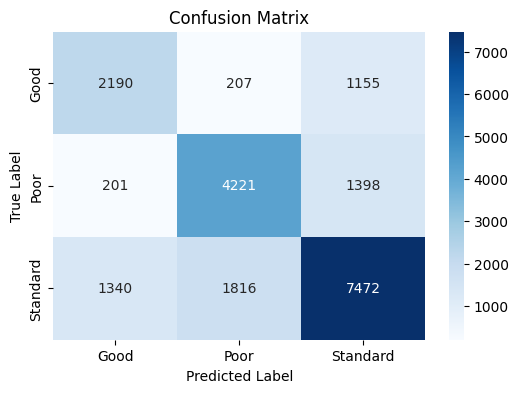

In [57]:
cm = confusion_matrix(y_val, y_pred)

plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=le3.classes_,
            yticklabels=le3.classes_)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

## `iii` Regularization Mode: On

Let's try contraining the model a bit. Change the default $max_depth$ parameter.

`Q` Does this simple regularization make the model generalize better?
- Yes, It gives me higher accuracy , f1_score.

In [58]:
Regularized_model = DecisionTreeClassifier(criterion='gini', splitter='best', max_depth=15, min_samples_leaf=2, min_samples_split= 2, random_state = 1234)
Regularized_model.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=15, min_samples_leaf=2, random_state=1234)

In [59]:
class_names = le3.classes_

tree_depth = Regularized_model.get_depth()
num_leaves = Regularized_model.get_n_leaves()
# Dynamically adjust figure size based on tree complexity
fig_width = max(10, 3 * tree_depth)
fig_height = max(5, 2 * num_leaves**0.5)

fig, ax = plt.subplots(figsize=(fig_width, fig_height), dpi=300)
plot_tree(Regularized_model, feature_names=X_train.columns, class_names=class_names, filled=True, fontsize=10, ax=ax)
plt.show()

In [60]:
y_pred_regular = Regularized_model.predict(X_val)

In [61]:
accuracy = accuracy_score(y_val, y_pred_regular)
print(f'Accuracy: {accuracy:.4f}')

print("Classification Report:\n", classification_report(y_val, y_pred_regular))

Accuracy: 0.6963
Classification Report:
               precision    recall  f1-score   support

           0       0.53      0.63      0.57      3552
           1       0.71      0.70      0.71      5820
           2       0.76      0.72      0.74     10628

    accuracy                           0.70     20000
   macro avg       0.67      0.68      0.67     20000
weighted avg       0.70      0.70      0.70     20000



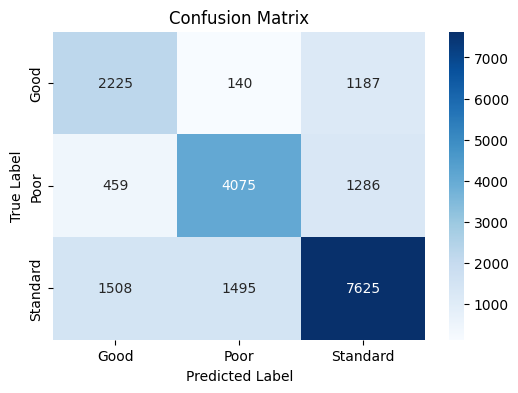

In [62]:
cm = confusion_matrix(y_val, y_pred_regular)

plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=le3.classes_,
            yticklabels=le3.classes_)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

## `iv` Tuning Hyperparameters

Try different **reasonable & logical** regularization hyperparameter values and evaluate.

`Q` What is the best hyperparamters value combination?<br>
`Best hyperparameters : {'ccp_alpha': 0.0, 'max_depth': 15, 'max_features': None, 'min_samples_leaf': 2, 'min_samples_split': 2}`<br>
`Note:` Make sure to tune only reasonable hyperparameter values as per the dataset characteristics.

`Note:` Make sure you elaborate your reasoning behind selecting each of the hyperparameters.

`Hint:` You might want to use `sklearn.model_selection.RandomizedSearchCV` or `sklearn.model_selection.GridSearchCV` classes.

`Hint:` It could be useful, and time saving, to start the tuning with a wider range using `RandomizedSearchCV` then switch to a finer range using `GridSearchCV` once you have found the near optimal area for the hyperparameter.

In [63]:
# Define the parameter grid for RandomizedSearchCV
param = {
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10, 20, 30],
    'min_samples_leaf': [1, 2, 4, 8],
    'max_features': [None, 'sqrt', 'log2'],
    'ccp_alpha': [0.0, 0.01, 0.1]
}

# Create a DecisionTreeClassifier
model = DecisionTreeClassifier(random_state=1234)

# Perform RandomizedSearchCV
random_search = RandomizedSearchCV(estimator=model, param_distributions=param, n_iter=50, cv=5, scoring='accuracy', n_jobs=-1, verbose=1, random_state=42)
random_search.fit(X_train, y_train)


print("Best hyperparameters:", random_search.best_params_)
print("Best accuracy score:", random_search.best_score_)
print("-------------------------------------------------------")


# Use the best hyperparameters found by RandomizedSearchCV to perform GridSearchCV
best_params = random_search.best_params_

param_grid = {
    'max_depth': [best_params['max_depth'], best_params['max_depth'] + 5, best_params['max_depth'] - 5],
    'min_samples_split': [best_params['min_samples_split'], best_params['min_samples_split'] + 5, best_params['min_samples_split'] - 5],
    'min_samples_leaf': [best_params['min_samples_leaf'], best_params['min_samples_leaf'] + 2, best_params['min_samples_leaf'] - 2],
    'max_features': [best_params['max_features']],
    'ccp_alpha': [best_params['ccp_alpha'], best_params['ccp_alpha'] + 0.01, best_params['ccp_alpha'] - 0.01]
}


grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

print("Best hyperparameters (GridSearchCV):", grid_search.best_params_)
print("Best accuracy score (GridSearchCV):", grid_search.best_score_)
print("-------------------------------------------------------")

# Evaluate the best model on the validation set
best_model = grid_search.best_estimator_
y_pred_tuned = best_model.predict(X_val)
accuracy_tuned = accuracy_score(y_val, y_pred_tuned)
print(f"Accuracy of tuned model on validation set: {accuracy_tuned:.4f}")
print("-------------------------------------------------------")
print("-------------------------------------------------------")

print("Classification Report:\n", classification_report(y_val, y_pred_tuned))


Fitting 5 folds for each of 50 candidates, totalling 250 fits
Best hyperparameters: {'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': None, 'max_depth': 10, 'ccp_alpha': 0.0}
Best accuracy score: 0.68975
-------------------------------------------------------
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Best hyperparameters (GridSearchCV): {'ccp_alpha': 0.0, 'max_depth': 15, 'max_features': None, 'min_samples_leaf': 2, 'min_samples_split': 2}
Best accuracy score (GridSearchCV): 0.6917666666666665
-------------------------------------------------------
Accuracy of tuned model on validation set: 0.6963
-------------------------------------------------------
-------------------------------------------------------
Classification Report:
               precision    recall  f1-score   support

           0       0.53      0.63      0.57      3552
           1       0.71      0.70      0.71      5820
           2       0.76      0.72      0.74     10628

    acc

## `v` Feature Importance

Explore the feature importances calculated by the best model.

`Note:` Visualizing the importances would help extract insights.

`Q` Do the importance values make sense?
- Yes, the top features are relevant to credit card scores.
- `Outstanding_Debt` is the most important because high debt usually lowers the score.

`Q` Can you intrepet the importance of the few top features?
- `Outstanding_Debt`: More debt means lower score.
- `Credit_Mix`: Having different credit types can help.
- `Interest_Rate`: High rates may mean risky behavior.
- `Changed_Credit_Limit`: Big changes can show money problems.

In [64]:
best_model.feature_importances_

array([0.12243127, 0.39182886, 0.17465502, 0.0105605 , 0.04936434,
       0.127519  , 0.12364101])

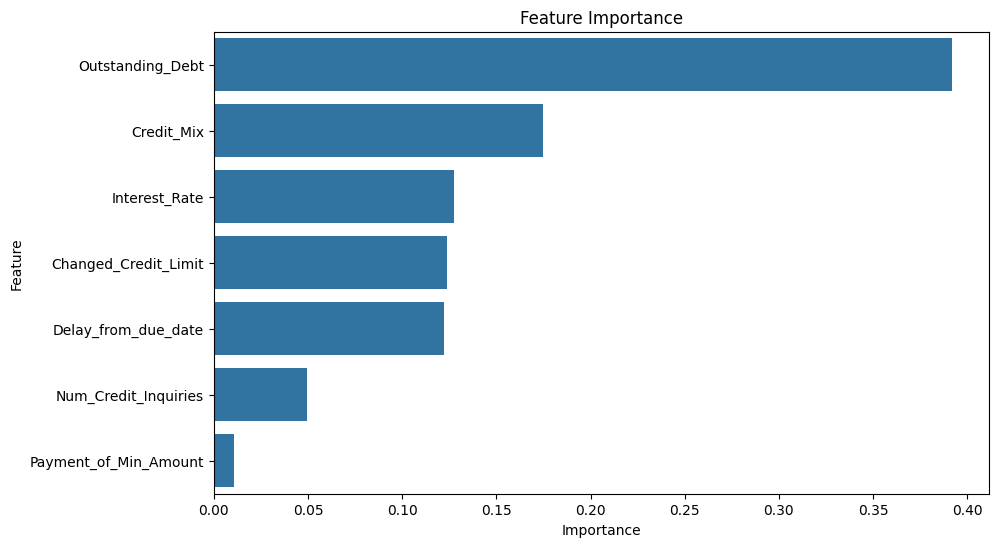

In [65]:
importances = best_model.feature_importances_
feature_names = best_model.feature_names_in_

# Create a DataFrame for better visualization
importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Plot feature importances
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title('Feature Importance')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

------------------

# `07` Generalization Error

Now that we have tuned our solution, to an *extent*, we need to test for a final time on the held out test set.

In [66]:
models = {
    "Baseline model": Baseline_model,  # Baseline model
    "Regularized model": Regularized_model,  # Regularized model
    "Best model": best_model       # Best model
}

for name, model in models.items():
    print(f"\n===== {name} =====")

    # Predictions
    y_test_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_test_pred)
    precision = precision_score(y_test, y_test_pred, average='weighted')
    recall = recall_score(y_test, y_test_pred, average='weighted')
    f1 = f1_score(y_test, y_test_pred, average='weighted')
    conf_matrix = confusion_matrix(y_test, y_test_pred)

    print(f'Accuracy: {accuracy:.4f}')
    print(f'Precision: {precision:.4f}')
    print(f'Recall: {recall:.4f}')
    print(f'F1 Score: {f1:.4f}')
    print('Confusion Matrix:')
    print(conf_matrix)


===== Baseline model =====
Accuracy: 0.6951
Precision: 0.6980
Recall: 0.6951
F1 Score: 0.6959
Confusion Matrix:
[[2171  237 1150]
 [ 218 4229 1375]
 [1339 1779 7502]]

===== Regularized model =====
Accuracy: 0.6962
Precision: 0.7039
Recall: 0.6962
F1 Score: 0.6988
Confusion Matrix:
[[2285  151 1122]
 [ 446 4076 1300]
 [1538 1520 7562]]

===== Best model =====
Accuracy: 0.6962
Precision: 0.7039
Recall: 0.6962
F1 Score: 0.6988
Confusion Matrix:
[[2285  151 1122]
 [ 446 4076 1300]
 [1538 1520 7562]]


----------------------------------------------

$$ Wish \space you \space all \space the \space best \space ♡ $$
